In [ ]:
!pip install -e mmdetection

load checkpoint from local path: iter_3000.pth


e:\onedrive\stonybrook\computational materials\dataextractor\lineformer-main\mmdetection\mmdet\datasets\utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
c:\Users\31376\AppData\Local\Programs\Python\Python39\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3484.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
C:\Users\31376\AppData\Local\Temp\ipykernel_15176\41197130.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control 

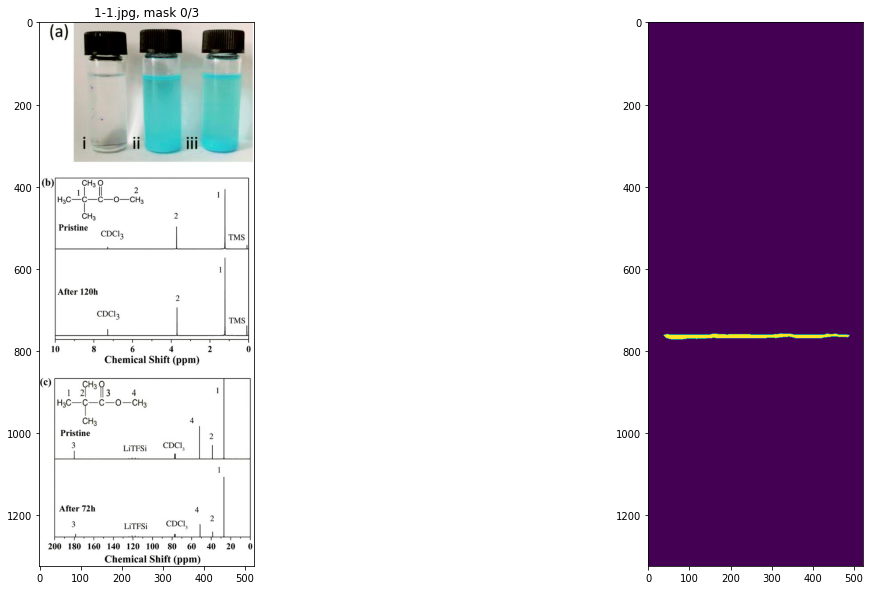

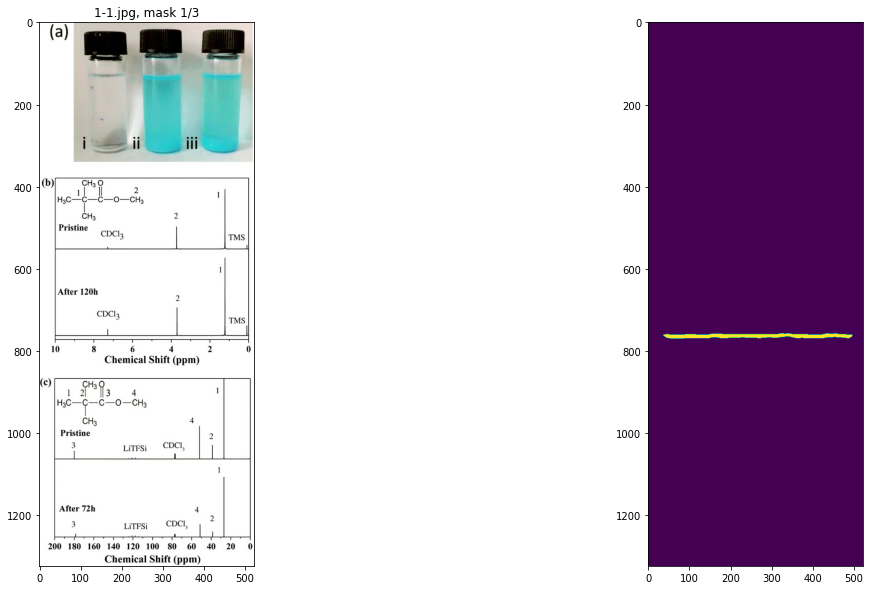

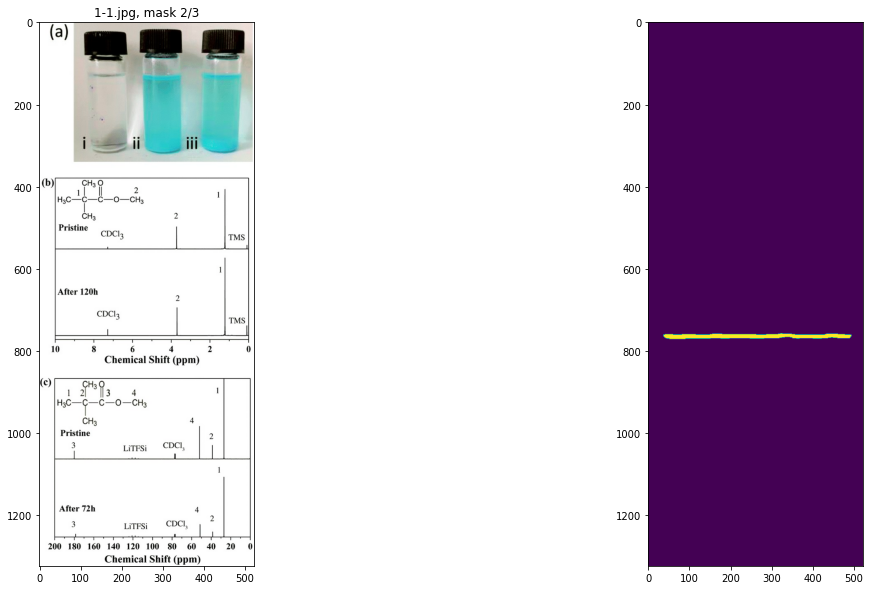

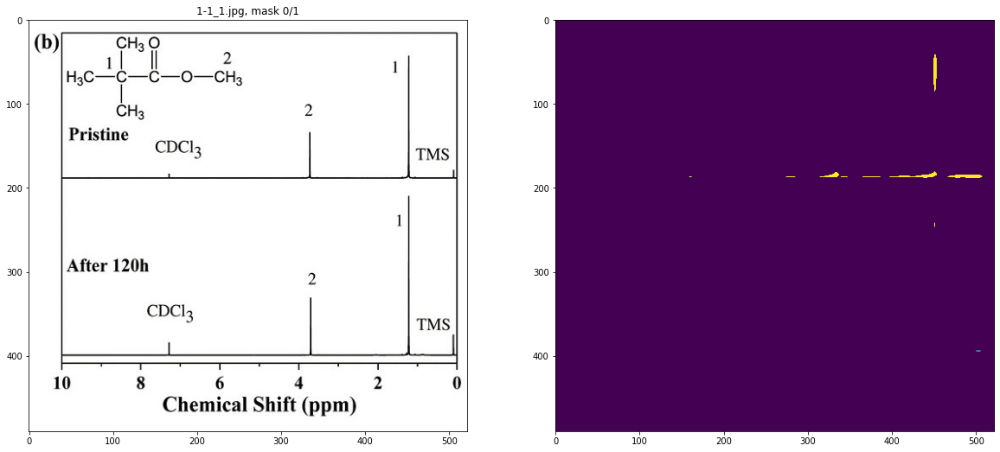

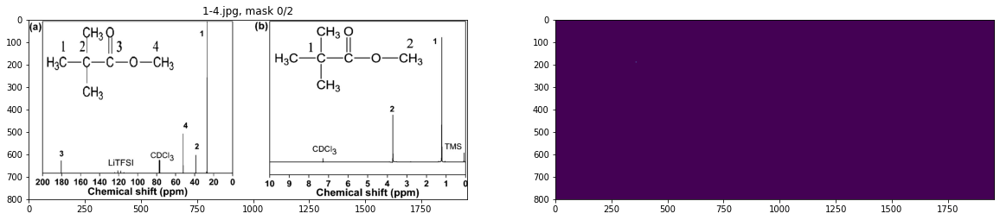

...

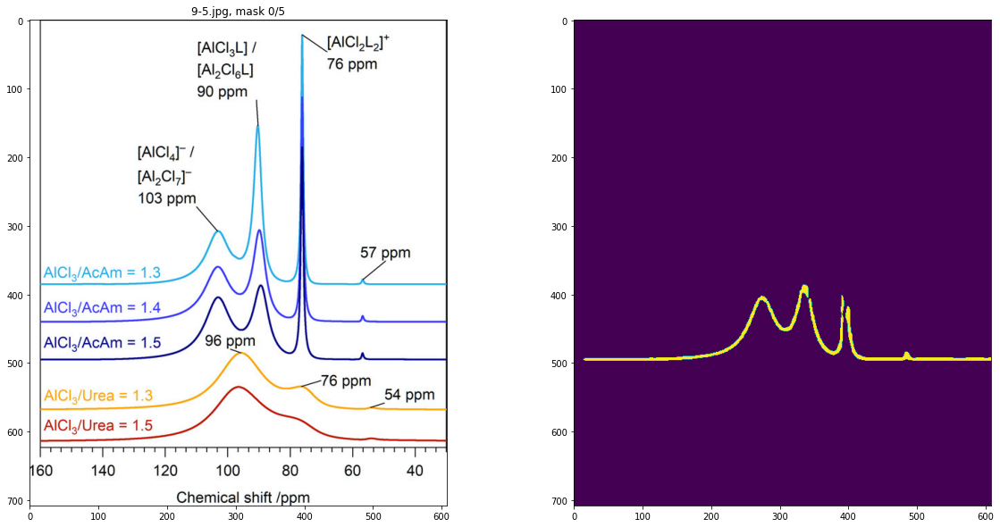

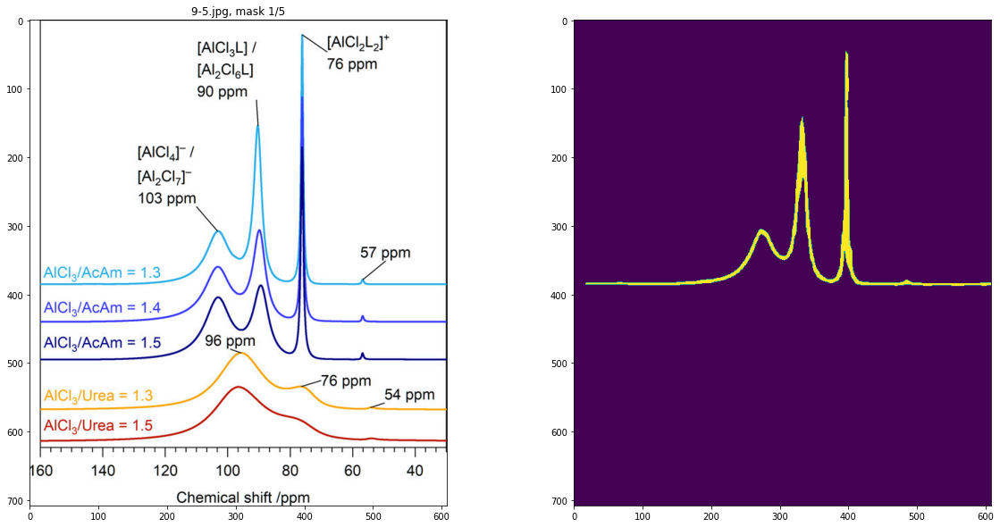

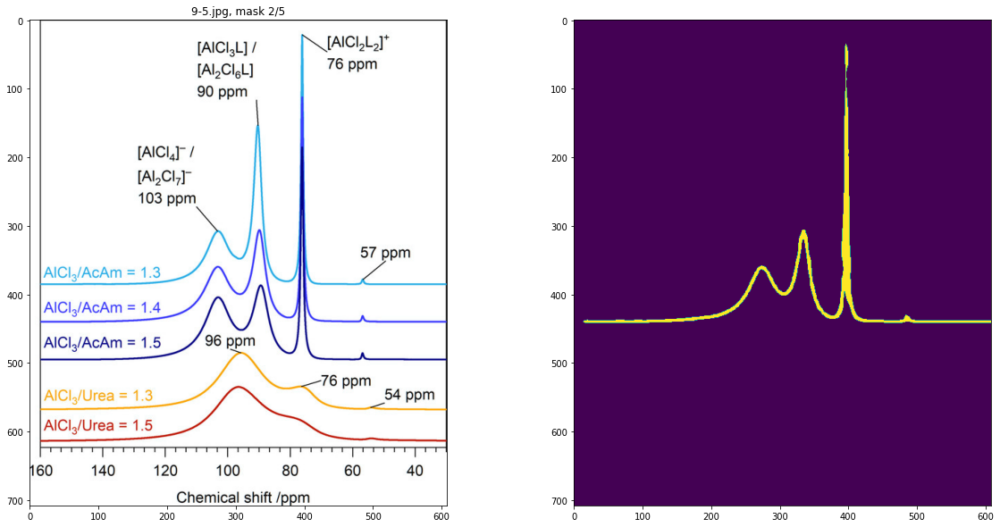

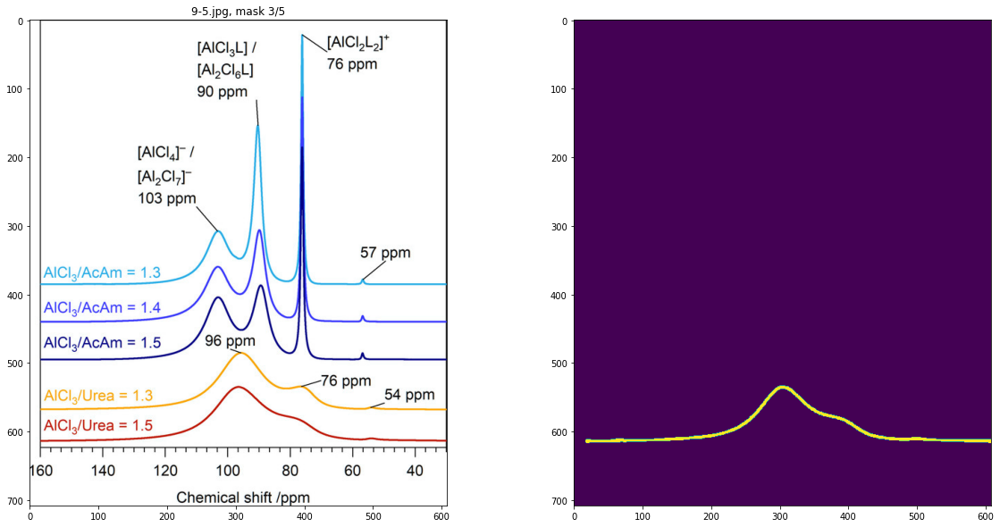

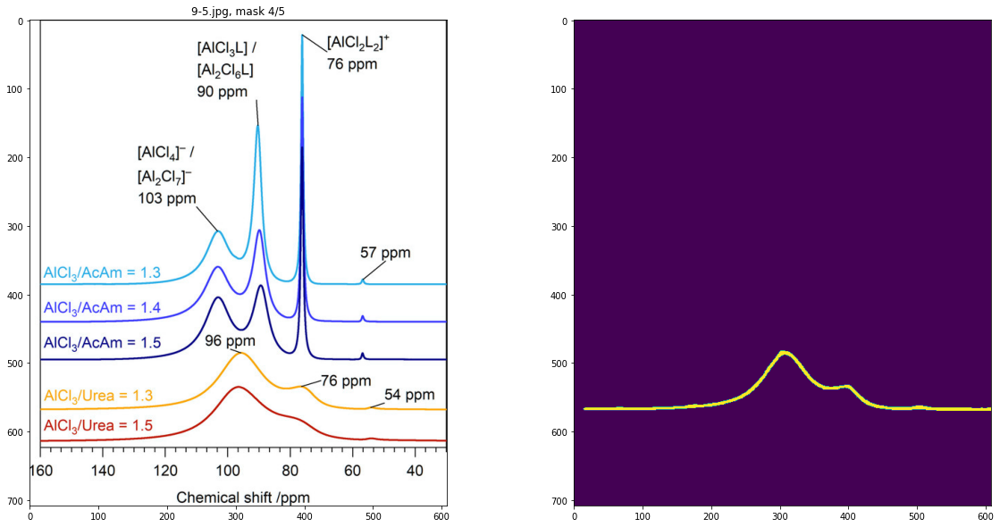

In [5]:
import infer
import cv2
import os
import shutil
import line_utils
import matplotlib.pyplot as plt
img_path='./test2'
CKPT = "iter_3000.pth"
CONFIG = "lineformer_swin_t_config.py"
DEVICE = "cpu"

infer.load_model(CONFIG, CKPT, DEVICE)
for roots in os.listdir(img_path):
    roots=os.path.join(img_path,roots)
    imgs=os.listdir(roots)
    res_path=os.path.join(roots,'masks')
    if os.path.exists(res_path):
        shutil.rmtree(res_path)
    os.makedirs(res_path)
    for i in range(len(imgs)):
        if os.path.isdir(os.path.join(roots,imgs[i])):
            continue
        img=cv2.imread(os.path.join(roots,imgs[i]))
        line_dataseries,masks = infer.get_dataseries(img, to_clean=False,return_masks=True)
        mask_num=len(masks)
        for j in range(mask_num):
            plt.figure(figsize=(20, 10))
            plt.subplot(1, 2, 1)
            plt.imshow(img)
            plt.title(f'{imgs[i]}, mask {j}/{mask_num}')
            plt.subplot(1, 2, 2)
            plt.imshow(masks[j])
            plt.savefig(os.path.join(res_path,f"{imgs[i].split('.')[0]}_mask_{j}.jpg"))
            # plt.show()
        # plt.figure(figsize=(20, 10))
        # plt.subplot(1, 2, 1)
        # plt.imshow(img)
        # plt.subplot(1, 2, 2)
        # plt.imshow(masks[1])
        # plt.show()
#     if os.path.isdir(os.path.join(roots,imgs[i])):
#         continue
#     img=cv2.imread(os.path.join(img_path,imgs[i]))
#     line_dataseries,masks = infer.get_dataseries(img, to_clean=False,return_masks=True)
#     mask_num=len(masks)
#     res_path=os.path.join(img_path,imgs[i].split('.')[0])
#     if not os.path.exists(res_path):
#         os.makedirs(res_path)
#     for j in range(mask_num):
#         plt.figure(figsize=(20, 10))
#         plt.title(f'{imgs[i]}, mask {j}/{mask_num}')
#         plt.subplot(1, 2, 1)
#         plt.imshow(img)
#         plt.subplot(1, 2, 2)
#         plt.imshow(masks[j])
#         plt.savefig(os.path.join(res_path,f'mask_{j}.jpg'))
# plt.show()
# plt.figure(figsize=(20, 10))
# plt.subplot(1, 2, 1)
# plt.imshow(img)
# plt.subplot(1, 2, 2)
# plt.imshow(masks[1])
# plt.show()

In [ ]:
import infer
import cv2
import line_utils
import matplotlib.pyplot as plt

img_path = "test/1-1.jpg"
img = cv2.imread(img_path)  # BGR format
CKPT = "iter_3000.pth"
CONFIG = "lineformer_swin_t_config.py"
DEVICE = "cpu"

infer.load_model(CONFIG, CKPT, DEVICE)
# print(infer.model)
line_dataseries,masks = infer.get_dataseries(img, to_clean=False,return_masks=True)
print(f'masks:{len(masks)}')
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(img)
plt.subplot(1, 2, 2)
plt.imshow(masks[1])
plt.show()
# Visualize extracted line keypoints
# img = line_utils.draw_lines(img, line_utils.points_to_array(line_dataseries))
# cv2.imwrite(img_path.replace('.','_res.'), img)

In [ ]:
infer.model